# Final Project Proposal - Due Sunday March 25

Your final project is to create a public visualization using data relevant to a current policy, business, or justice issue. You may use any dataset you can find for this assignment, as long as it is either public or you have permission from the data’s owner/administrator to work with it and share it.

Recommended data sources are: governmental data, data provided by a non-profit/Nongovernmental organizations, and data available from large, semi-structured data sets (ie social networks, company financials, etc).

You must document each step of your data analysis process (excluding data acquisition) in code: this will include changing the format of the data and the creation of any images or interactive displays that are made.

You must also include a short (2-3 paragraph) write-up on the visualization. This write-up must include the following: the data source, what the parameters of the data set are (geography, timeframe, what the data points are, etc) what the data shows, and why it is important.


## Grading:

This assignment will account for 40% of your final grade. Points will be awarded for the following components:
- 25% - finding your dataset(s) and getting approval for your project on-time, recognition of strength/weaknesses of data, analysis to find insights in the data
- 25% - data handling: cleaning, outlier/null handling, and transfer/loading data to the web
- 40% - data presentation: compliance with best data visualization practices, clarity, information-to-ink ratio, how memorable the visualization is
- 10% - contextual write-up: why the data is important, why the insights are important Due Dates:

Note - The type of deliverable you provide will depend on the strategy you use for this project. If you put together an interactive visualization, you should be able to provide code that I will be able to run and host locally. If you are choosing static visualizations, your write up will be more important to your overall grade, and it may be useful to think about how you’re presenting these visualizations (in a formated R markdown document for example.)


## Proposal

You must submit a proposal for your project by 03/26. This proposal must include: a link to the data source, an explanation of what you want to show, why this is relevant to a current policy, business, or justice issue, and which technologies you plan to use.

Your instructor must approve this proposal: you may have to refine this somewhat. You will present your final project during our last meetup. If you are not able to attend the lecture on those days, you must write-up a status report with screenshots of current progress and issues you are experiencing.

# Proposal

This project will use the mothly citybike rider data to generate a visualization. The citybike data is available through the a non-exclusive, royalty-free, limited, perpetual license from CityBike direclty or throught a creative commons license from Googles Big Query. It appears to be the same data set available through 2 different channels. 

This projec will explore the geo spacial representation of the data vs the graph represenation of the same data set. 

# Data Source




The data sources I selected 

Google offers several data sets for analysis

bigquery

New York City Bike data


bigquery-public-data.new_york_citibike.citibike_trips


Welcome to BigQuery in the Cloud Console

New to the BigQuery UI?
The BigQuery UI helps you complete tasks like running queries, loading data and even creating and training ML models. Take a look at the BigQuery quickstart guide to learn how to start performing data analysis on Google Cloud.

Learn about new features
New improvements and updates are constantly on the way. We recommend periodically checking our release notes to stay up to date on what's new.


https://s3.amazonaws.com/tripdata/index.html

https://citibikenyc.com/system-data


https://ride.citibikenyc.com/data-sharing-policy












In [392]:
import numpy as np
import pandas as pd
import json
import folium

In [393]:
graph_factor = 0.1
hurdle_rate = 12

# Data Source

For this analysis we are using data from googles big query applciations 

In [394]:
df = pd.read_csv('./202302-citibike-tripdata.csv', nrows=40000, parse_dates=['started_at','ended_at'])
df.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,16991A7C313082EB,classic_bike,2023-02-16 18:20:42,2023-02-16 18:38:06,Kosciuszko St & Nostrand Ave,4519.04,Eastern Pkwy & Troy Ave,3862.07,40.690698,-73.951423,40.669290,-73.936790,casual
1,856FFB566BEEB824,classic_bike,2023-02-09 17:29:36,2023-02-09 17:33:07,Riverside Dr & W 138 St,7942.21,St. Nicholas Terrace & Convent Ave,7937.15,40.823134,-73.955860,40.821294,-73.947868,member
2,B1FE28D50B493430,classic_bike,2023-02-16 15:33:51,2023-02-16 15:35:01,Clinton St & Tillary St,4748.07,Clark St & Henry St,4789.03,40.696233,-73.991421,40.697601,-73.993446,member
3,870EA3D724EA6162,classic_bike,2023-02-23 17:11:39,2023-02-23 17:12:56,Clinton St & Tillary St,4748.07,Clark St & Henry St,4789.03,40.696233,-73.991421,40.697601,-73.993446,member
4,7DE8FA9EAAE8C4ED,electric_bike,2023-02-18 19:29:17,2023-02-18 19:50:52,Audubon Ave & W 192 St,8469.05,St. Nicholas Terrace & Convent Ave,7937.15,40.855890,-73.927082,40.821294,-73.947868,member


In [395]:
df.shape

(40000, 13)

In [396]:
df.columns

Index(['ride_id', 'rideable_type', 'started_at', 'ended_at',
       'start_station_name', 'start_station_id', 'end_station_name',
       'end_station_id', 'start_lat', 'start_lng', 'end_lat', 'end_lng',
       'member_casual'],
      dtype='object')

In [397]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   ride_id             40000 non-null  object        
 1   rideable_type       40000 non-null  object        
 2   started_at          40000 non-null  datetime64[ns]
 3   ended_at            40000 non-null  datetime64[ns]
 4   start_station_name  40000 non-null  object        
 5   start_station_id    40000 non-null  float64       
 6   end_station_name    39832 non-null  object        
 7   end_station_id      39832 non-null  object        
 8   start_lat           40000 non-null  float64       
 9   start_lng           40000 non-null  float64       
 10  end_lat             39964 non-null  float64       
 11  end_lng             39964 non-null  float64       
 12  member_casual       40000 non-null  object        
dtypes: datetime64[ns](2), float64(5), object(6)
me

In [432]:
import folium
m = folium.Map(location=[40.730610, -73.935242],zoom_start=13, tiles = 'CartoDB Positron')
m

In [399]:
df.columns

Index(['ride_id', 'rideable_type', 'started_at', 'ended_at',
       'start_station_name', 'start_station_id', 'end_station_name',
       'end_station_id', 'start_lat', 'start_lng', 'end_lat', 'end_lng',
       'member_casual'],
      dtype='object')

In [400]:
df.shape

(40000, 13)

In [401]:
start_df = df.groupby(['start_station_id','start_station_name','start_lat','start_lng'])[['ride_id']].count().reset_index()
start_df.rename(columns={'ride_id':'count'}, inplace=True)
start_df

,start_station_id,start_station_name,start_lat,start_lng,count
0,2733.03,67 St & Erik Pl,40.633385,-74.016562,1
1,2782.02,5 Ave & 66 St,40.635679,-74.020005,2
2,2912.08,6 Ave & 60 St,40.638196,-74.013821,4
3,2912.08,6 Ave & 60 St,40.638205,-74.013700,1
4,2912.08,6 Ave & 60 St,40.638230,-74.013772,1
...,...,...,...,...,...
13602,8799.01,Goulden Ave & W 205 St,40.878322,-73.891773,1
13603,8811.01,Paul Ave & Mosholu Pkwy,40.880294,-73.886065,6
13604,8811.01,Paul Ave & Mosholu Pkwy,40.880299,-73.886069,1
13605,8811.01,Paul Ave & Mosholu Pkwy,40.880310,-73.886092,1


In [402]:
end_df = df.groupby(['end_station_id','end_station_name','end_lat','end_lng'])[['ride_id']].count().reset_index()
end_df.rename(columns={'ride_id':'count'}, inplace=True)
end_df

,end_station_id,end_station_name,end_lat,end_lng,count
0,2733.03,67 St & Erik Pl,40.633385,-74.016562,8
1,2782.02,5 Ave & 66 St,40.635679,-74.020005,6
2,2912.08,6 Ave & 60 St,40.638196,-74.013821,9
3,2923.01,62 St & 4 Ave,40.639859,-74.019776,32
4,3007.05,Church Ave & Story St,40.642031,-73.981073,31
...,...,...,...,...,...
498,8778.01,E Mosholu Pkwy & Van Cortlandt Ave E,40.876560,-73.883660,2
499,8795.03,Grand Concourse & E Mosholu Pkwy S,40.877964,-73.884755,3
500,HB202,14 St Ferry - 14 St & Shipyard Ln,40.752961,-74.024353,1
501,JC072,Morris Canal,40.712419,-74.038526,1


In [403]:
for i in range(0,len(start_df)):
   folium.Circle(
        location=[start_df.iloc[i]['start_lat'], start_df.iloc[i]['start_lng']],
        radius=float(start_df.iloc[i]['count'])*graph_factor,
        popup=start_df.iloc[i]['start_station_name'],
        color="green",
        fill=True,
        fill_color="green"
   ).add_to(m)

for i in range(0,len(end_df)):
   folium.Circle(
        location=[end_df.iloc[i]['end_lat'], end_df.iloc[i]['end_lng']],
        radius=float(end_df.iloc[i]['count'])*graph_factor,
        popup=end_df.iloc[i]['end_station_name'],
        color="red",
        fill=True,
        fill_color="red"
   ).add_to(m)

m

In [404]:
trip_df = df.groupby(['start_station_id','start_station_name','start_lat','start_lng',
                     'end_station_id','end_station_name','end_lat','end_lng'])[['ride_id']].count().reset_index()
trip_df.rename(columns={'ride_id':'count'}, inplace=True)
trip_df = trip_df[trip_df['count'] > hurdle_rate]
trip_df.shape

(340, 9)

In [405]:
for i in range(0,len(trip_df)):
    lat_lng_points = list()
    lat_lng_points.append(trip_df.iloc[i][['start_lat','start_lng']].values.tolist())
    lat_lng_points.append(trip_df.iloc[i][['end_lat','end_lng']].values.tolist())
    #lat_lng_points
    
    folium.PolyLine(lat_lng_points,
                    color='gray',
                    tooltip=trip_df.iloc[i]['count'],
                    weight=float(trip_df.iloc[i]['count'])*graph_factor,  # line thickness
                    opacity=0.2  # transparency
                    ).add_to(m)
    
m

# Network Visualization



In [406]:
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

import networkx as nx
import warnings
from scipy.stats import ttest_ind
plt.rcParams.update({'axes.facecolor':'orange'})
warnings.filterwarnings("ignore")

In [420]:
# method to trim graph by edge weights
def trim_edges(g, weight=1):
    g2=nx.Graph()
    for f, to, edata in g.edges(data=True):
        if edata['count'] > weight:
            g2.add_edge(f,to,**edata)
    return g2 

In [417]:
list(trip_df.columns)

['start_station_id',
 'start_station_name',
 'start_lat',
 'start_lng',
 'end_station_id',
 'end_station_name',
 'end_lat',
 'end_lng',
 'count']

In [418]:
# filter dataset
#df = df_merge
#df = df_merge[df_merge['speaker'] == 'Chairman Jerome H. Powell']
#df = df_merge[df_merge['speaker'] == 'Chairman Alan Greenspan']


# create the graph with the two node types
B = nx.Graph()
B.add_nodes_from(df['start_station_id'], bipartite=0)
B.add_nodes_from(df['end_station_id'], bipartite=1)

# add the weights
tuples = trip_df[['start_station_id','end_station_id','count']].to_numpy()
B.add_weighted_edges_from(tuples, weight='count')

# test to see if the graph is connected
print('We confirm that connected status of the graph. Graph connected status:',nx.is_connected(B))

# verify that a bipartite graph was created
print('We also confirmed that the the graph is a bipartite graph. Graph bipartite status:',nx.is_bipartite(B))

# create node lists for each node type
rate_nodes = {n for n, d in B.nodes(data=True) if d["bipartite"] == 0}
speech_nodes = set(B) - rate_nodes

We confirm that connected status of the graph. Graph connected status: False
We also confirmed that the the graph is a bipartite graph. Graph bipartite status: True


In [429]:
# variable for the target weight
filter_weight = 0.5       
filter_B = trim_edges(B,filter_weight) 

<Figure size 1500x1000 with 0 Axes>

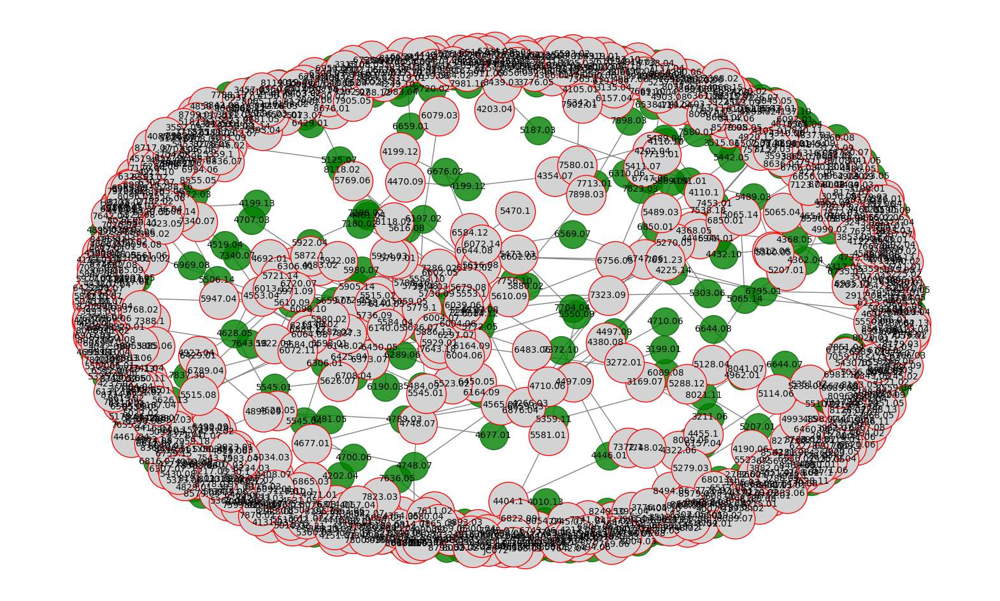

In [430]:
plt.figure(figsize = (15,10))
pos = nx.spring_layout(B, seed=34, k=0.2)
#pos = nx.random_layout(filter_B)
#pos = nx.shell_layout(filter_B)
#pos = nx.bipartite_layout(filter_B,rate_nodes)

fig, ax = plt.subplots(figsize = (20,12))


edge_labels = nx.get_edge_attributes(filter_B, 'weight')
edge_w = np.array(list(edge_labels.values())) * 50


#topic = weighted_2mode['Topic']
nx.draw_networkx_nodes(B,pos,
                       nodelist=speech_nodes,
                       node_color='green',
                       node_size=1000,
                       edgecolors='darkgreen',
                       alpha=0.8)

nx.draw_networkx_nodes(B,pos,
                       nodelist=rate_nodes,
                       node_color='lightgray',
                       node_size=2000,
                       edgecolors='red',
                       alpha=1)

nx.draw_networkx_edges(filter_B, pos,
                       edge_color='gray',
                       width=edge_w, 
                       #edge_color=edge_w,
                      )


ax.set_facecolor('white')
ax.axis('off')
fig.set_facecolor('white')
_0 = nx.draw_networkx_labels(B, pos, font_size=10)